<h1 align=center><font size = 5>Segmenting the best places to live in Bogota - Colombia</font></h1>
<h2 align=center><font size = 4>According to an economic, social and life quality approach</font></h2>



## Table of contents
* [1. Introduction: Business Problem](#background)
* [2. Data](#data)
* [3. Methodology](#methodology)
* [4. Analysis](#analysis)
* [5. Results and Discussion](#results)
* [6. Conclusion](#conclusion)

## 1. Introduction <a name="introduction"></a>

###  Background 
Bogotá is the capital of Colombia and the administrative and economic center of the country. This city is divided into 20 boroughs, 112 zones planning units, 1169 cadastral areas and 988 neighborhoods . 

Each area of the city is classified depending on the characteristics of the houses, the urban environment of the area, and the urban context. Thus, the city is subdivided into 6 socio-economic sectors, which the number 1 being the lowest and 6 the highest. To identify areas of action and distribute the cost of public services, where the higher sectors subsidize the lower ones and these, in turn, can access education or health benefits given the classification. Consequently, each citizen has to pay the cost of public services according to a sector, the number 6 pays more than 1. All this results in a social classification of rich and poor people. This has allowed the city to quickly identify vulnerable sectors and, among other things, has managed to guarantee free minimum vital water consumption to sectors 1 and 2.  

The real estate market encompasses all these factors in order to provide a price and quality of life advantages that should be analyzed when choosing a home.


### The Problem
A married couple lives in the suburbs of Bogota and every day they take 2 hours per way to arrive at home or work. Bogota has a big problem with its traffic, there are a lot of cars and public transportations is not good at all as an incentive to take it. Because of this, they decide to move to Bogota under the following conditions:

1. The new place has to be close to their jobs.
2. Only they can afford up to sector 4.
3. They do not want to live in sectors 1 and 2.

It should be a supermarket, pharmacies, and bus stations close to the new place.
This project aims them to choose the best place to live according to their rules and based on Foursquare and governmental data from Bogota.


## 2. Data <a name="data"></a>

Before we get the data and start exploring it, let's download all the dependencies that we will need.

In [7]:

import numpy as np # library to handle data in a vectorized manner
import math

import pandas as pd # library for data analsysis
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)
from sklearn.preprocessing import MinMaxScaler


import ssl
import numpy as np
ssl._create_default_https_context=ssl._create_unverified_context

import geopandas as gpd

import json # library to handle JSON files
import geojson
import seaborn as sns
import matplotlib.pyplot as plt
from scipy import stats
from geopy.geocoders import Nominatim # convert an address into latitude and longitude values


import requests # library to handle requests
from pandas.io.json import json_normalize # tranform JSON file into a pandas dataframe

# Matplotlib and associated plotting modules
import matplotlib.cm as cm
import matplotlib.colors as colors

# import k-means from clustering stage
from sklearn.cluster import KMeans

import folium # map rendering library

from shapely.ops import cascaded_union
import json
import geog
import shapely.geometry
from shapely.geometry import Polygon


print('Libraries imported.')

Libraries imported.


###  Download and Explore Dataset

These dataset was downloaded in  https://www.datos.gov.co/ using a GeoPackage Format. First at all, we have to get all the boroughs

In [8]:
#Get boroughs
gdf_boroughs = gpd.read_file(r'Bogota.gpkg', layer='Loca')
gdf_boroughs=gdf_boroughs[['LocNombre','LocCodigo','SHAPE_Leng','SHAPE_Area','geometry']]
print(gdf_boroughs.shape)
gdf_boroughs.head()

(20, 5)


,LocNombre,LocCodigo,SHAPE_Leng,SHAPE_Area,geometry
0,ANTONIO NARIÑO,15,0.108973,0.000397,"POLYGON ((-74.13075 4.59335, -74.12917 4.59327..."
1,TUNJUELITO,06,0.210542,0.000807,"POLYGON ((-74.13777 4.59489, -74.13165 4.59363..."
2,RAFAEL URIBE URIBE,18,0.174513,0.001126,"POLYGON ((-74.12803 4.59254, -74.12777 4.59233..."
3,CANDELARIA,17,0.067158,0.000168,"POLYGON ((-74.06621 4.60317, -74.06620 4.60317..."
4,BARRIOS UNIDOS,12,0.121180,0.000969,"POLYGON ((-74.05725 4.68684, -74.06249 4.65594..."


In [9]:
gdf_boroughs.LocNombre

0         ANTONIO NARIÑO
1             TUNJUELITO
2     RAFAEL URIBE URIBE
3             CANDELARIA
4         BARRIOS UNIDOS
5            TEUSAQUILLO
6          PUENTE ARANDA
7           LOS MARTIRES
8                SUMAPAZ
9                USAQUEN
10             CHAPINERO
11              SANTA FE
12         SAN CRISTOBAL
13                  USME
14        CIUDAD BOLIVAR
15                  BOSA
16               KENNEDY
17              FONTIBON
18              ENGATIVA
19                  SUBA
Name: LocNombre, dtype: object

We confirm that we got all the 20 boroughs

In [10]:
#Get cadastral areas and neighborhoods
gdf_areas = gpd.read_file(r'Bogota.gpkg', layer='SCat')
gdf_areas = gdf_areas[['SCaTipo','SCaNombre','SCaCodigo','SHAPE_Leng','SHAPE_Area','geometry']]
print(gdf_areas.shape)
gdf_areas.head()

(1169, 6)


,SCaTipo,SCaNombre,SCaCodigo,SHAPE_Leng,SHAPE_Area,geometry
0,0,GINEBRA,008405,0.015404,0.000012,"POLYGON ((-74.02441 4.70958, -74.02473 4.70923..."
1,0,ATENAS,009119,0.026614,0.000022,"POLYGON ((-74.07302 4.73279, -74.07295 4.73278..."
2,0,LOS CEDROS ORIENTAL,008509,0.016383,0.000010,"POLYGON ((-74.03228 4.72542, -74.03143 4.72505..."
3,0,CEDRO NARVAEZ,008511,0.033577,0.000024,"POLYGON ((-74.03254 4.72139, -74.03239 4.72134..."
4,0,SALAZAR USME,002572,0.006979,0.000002,"POLYGON ((-74.11391 4.51906, -74.11387 4.51894..."


We confirm that we got all the 1169 cadastral areas

Now, we have to get all the information about classification sectors. This dataset has an issue in the field *CODIGO_MAN* bacause its needs a cero.

In [11]:
# Get Classification Sectors
gdf_ClassSectors = gpd.read_file(r'Bogota.gpkg', layer='ManzanaEstratificacion')
gdf_ClassSectors = gdf_ClassSectors[['CODIGO_MAN','ESTRATO']]
gdf_ClassSectors['CODIGO_MAN']=gdf_ClassSectors['CODIGO_MAN'].astype(str).str[0:6] + '0' + gdf_ClassSectors['CODIGO_MAN'].astype(str).str[6:8]
print(gdf_ClassSectors.shape)
gdf_ClassSectors.head()

(45051, 2)


,CODIGO_MAN,ESTRATO
0,009136033,0
1,1081010A1,6
2,009136034,0
3,009136026,6
4,008539003,0


In [12]:
# Get Blocks
gdf_blocks = gpd.read_file(r'Bogota.gpkg', layer='Manz')
gdf_blocks = gdf_blocks[['ManCodigo','SecCodigo','SHAPE_Leng','SHAPE_Area','geometry']]
print(gdf_blocks.shape)
gdf_blocks.head()

(43907, 5)


,ManCodigo,SecCodigo,SHAPE_Leng,SHAPE_Area,geometry
0,008520013,008520,0.001817,9.897130e-08,"POLYGON ((-74.02287 4.73709, -74.02288 4.73709..."
1,008520014,008520,0.001326,8.577165e-08,"POLYGON ((-74.02198 4.73747, -74.02207 4.73732..."
2,008520017,008520,0.001332,9.888299e-08,"POLYGON ((-74.02196 4.73690, -74.02198 4.73686..."
3,008520022,008520,0.001982,1.521141e-07,"POLYGON ((-74.02151 4.73493, -74.02155 4.73486..."
4,008520026,008520,0.001365,8.470870e-08,"POLYGON ((-74.02028 4.73527, -74.02024 4.73526..."


In [13]:
# Get Plots Land
gdf_plotsLandAll = gpd.read_file(r'Bogota.gpkg', layer='predio2')
print(gdf_plotsLandAll.shape)
gdf_plotsLandAll.head()

(3497222, 7)


,PreCBarrio,PreNBarrio,PreCManz,PreCPredio,PreChip,PreNupre,geometry
0,205322,CAMPO VERDE,08,01,AAA0250CXMS,110010253072200080001915040001,None
1,205322,CAMPO VERDE,08,01,AAA0250CXLW,110010253072200080001915030004,None
2,205322,CAMPO VERDE,08,01,AAA0250CXKL,110010253072200080001915030003,None
3,205322,CAMPO VERDE,08,01,AAA0250CXJH,110010253072200080001915030002,None
4,205322,CAMPO VERDE,08,01,AAA0250CXHY,110010253072200080001915030001,None


The field *PreNupre* will be used to get the *Borough* and *ManzCod* fields. *codLote* is like the plots land and *ManzCod* is the block

In [14]:
gdf_plotsLandAll['Borough']=gdf_plotsLandAll['PreNupre'].astype(str).str[9:11]
gdf_plotsLandAll['ManzCod']=gdf_plotsLandAll['PreCBarrio'].astype(str)+gdf_plotsLandAll['PreNupre'].astype(str).str[14:17]
gdf_plotsLandAll.head()

,PreCBarrio,PreNBarrio,PreCManz,PreCPredio,PreChip,PreNupre,geometry,Borough,ManzCod
0,205322,CAMPO VERDE,08,01,AAA0250CXMS,110010253072200080001915040001,None,07,205322008
1,205322,CAMPO VERDE,08,01,AAA0250CXLW,110010253072200080001915030004,None,07,205322008
2,205322,CAMPO VERDE,08,01,AAA0250CXKL,110010253072200080001915030003,None,07,205322008
3,205322,CAMPO VERDE,08,01,AAA0250CXJH,110010253072200080001915030002,None,07,205322008
4,205322,CAMPO VERDE,08,01,AAA0250CXHY,110010253072200080001915030001,None,07,205322008


We can remove some fields y duplicates because we don't need all this data

In [15]:
gdf_neighborhoods=gdf_plotsLandAll[['PreCBarrio','PreNBarrio','Borough']]
gdf_neighborhoods=gdf_neighborhoods.drop_duplicates(subset='PreCBarrio', keep='first', ignore_index=True)
print(gdf_neighborhoods.shape)
gdf_neighborhoods.head()

(1595, 3)


,PreCBarrio,PreNBarrio,Borough
0,205322,CAMPO VERDE,07
1,008510,ACACIAS USAQUEN,01
2,006312,MODELIA OCCIDENTAL,09
3,008511,CEDRO NARVAEZ,01
4,205401,EL CHANCO II,09


## Datasets - Merge

In order to join *classification sectors* and *neighborhoods* datasets and get one where each classificaton match with its borough, we use the method *merge* from Pandas Library

In [16]:
# Merge Blocks and Classification Sectors
resultBC=pd.merge(gdf_blocks, gdf_ClassSectors, left_on='ManCodigo', right_on='CODIGO_MAN', how='left')
print(resultBC.shape)
resultBC.head()

(43907, 7)


,ManCodigo,SecCodigo,SHAPE_Leng,SHAPE_Area,geometry,CODIGO_MAN,ESTRATO
0,008520013,008520,0.001817,9.897130e-08,"POLYGON ((-74.02287 4.73709, -74.02288 4.73709...",008520013,0.0
1,008520014,008520,0.001326,8.577165e-08,"POLYGON ((-74.02198 4.73747, -74.02207 4.73732...",008520014,0.0
2,008520017,008520,0.001332,9.888299e-08,"POLYGON ((-74.02196 4.73690, -74.02198 4.73686...",008520017,2.0
3,008520022,008520,0.001982,1.521141e-07,"POLYGON ((-74.02151 4.73493, -74.02155 4.73486...",008520022,2.0
4,008520026,008520,0.001365,8.470870e-08,"POLYGON ((-74.02028 4.73527, -74.02024 4.73526...",008520026,2.0


In [17]:
# Merge Blocks, Classification Sectors and areas (each one has the neighboorhoods)
resultBCA=pd.merge(resultBC, gdf_areas[['SCaNombre','SCaCodigo']], left_on='SecCodigo', right_on='SCaCodigo', how='left')
print(resultBCA.shape)
resultBCA.head()

(43907, 9)


,ManCodigo,SecCodigo,SHAPE_Leng,SHAPE_Area,geometry,CODIGO_MAN,ESTRATO,SCaNombre,SCaCodigo
0,008520013,008520,0.001817,9.897130e-08,"POLYGON ((-74.02287 4.73709, -74.02288 4.73709...",008520013,0.0,BOSQUE DE PINOS,008520
1,008520014,008520,0.001326,8.577165e-08,"POLYGON ((-74.02198 4.73747, -74.02207 4.73732...",008520014,0.0,BOSQUE DE PINOS,008520
2,008520017,008520,0.001332,9.888299e-08,"POLYGON ((-74.02196 4.73690, -74.02198 4.73686...",008520017,2.0,BOSQUE DE PINOS,008520
3,008520022,008520,0.001982,1.521141e-07,"POLYGON ((-74.02151 4.73493, -74.02155 4.73486...",008520022,2.0,BOSQUE DE PINOS,008520
4,008520026,008520,0.001365,8.470870e-08,"POLYGON ((-74.02028 4.73527, -74.02024 4.73526...",008520026,2.0,BOSQUE DE PINOS,008520


In [18]:
# Merge Blocks, Classification Sectors, areas and plots land
resultBCAPl=pd.merge(resultBCA, gdf_neighborhoods, left_on='SecCodigo', right_on='PreCBarrio', how='inner')

print(resultBCAPl.shape)
resultBCAPl.head()

(43904, 12)


,ManCodigo,SecCodigo,SHAPE_Leng,SHAPE_Area,geometry,CODIGO_MAN,ESTRATO,SCaNombre,SCaCodigo,PreCBarrio,PreNBarrio,Borough
0,008520013,008520,0.001817,9.897130e-08,"POLYGON ((-74.02287 4.73709, -74.02288 4.73709...",008520013,0.0,BOSQUE DE PINOS,008520,008520,BOSQUE DE PINOS,01
1,008520014,008520,0.001326,8.577165e-08,"POLYGON ((-74.02198 4.73747, -74.02207 4.73732...",008520014,0.0,BOSQUE DE PINOS,008520,008520,BOSQUE DE PINOS,01
2,008520017,008520,0.001332,9.888299e-08,"POLYGON ((-74.02196 4.73690, -74.02198 4.73686...",008520017,2.0,BOSQUE DE PINOS,008520,008520,BOSQUE DE PINOS,01
3,008520022,008520,0.001982,1.521141e-07,"POLYGON ((-74.02151 4.73493, -74.02155 4.73486...",008520022,2.0,BOSQUE DE PINOS,008520,008520,BOSQUE DE PINOS,01
4,008520026,008520,0.001365,8.470870e-08,"POLYGON ((-74.02028 4.73527, -74.02024 4.73526...",008520026,2.0,BOSQUE DE PINOS,008520,008520,BOSQUE DE PINOS,01


In [19]:
# Merge Blocks, Classification Sectors, areas, plots land and boroughs
resultBCAPlB=pd.merge(resultBCAPl, gdf_boroughs[['LocNombre','LocCodigo']], left_on='Borough', right_on='LocCodigo', how='inner')
print(resultBCAPlB.shape)
resultBCAPlB.head()

(43904, 14)


,ManCodigo,SecCodigo,SHAPE_Leng,SHAPE_Area,geometry,CODIGO_MAN,ESTRATO,SCaNombre,SCaCodigo,PreCBarrio,PreNBarrio,Borough,LocNombre,LocCodigo
0,008520013,008520,0.001817,9.897130e-08,"POLYGON ((-74.02287 4.73709, -74.02288 4.73709...",008520013,0.0,BOSQUE DE PINOS,008520,008520,BOSQUE DE PINOS,01,USAQUEN,01
1,008520014,008520,0.001326,8.577165e-08,"POLYGON ((-74.02198 4.73747, -74.02207 4.73732...",008520014,0.0,BOSQUE DE PINOS,008520,008520,BOSQUE DE PINOS,01,USAQUEN,01
2,008520017,008520,0.001332,9.888299e-08,"POLYGON ((-74.02196 4.73690, -74.02198 4.73686...",008520017,2.0,BOSQUE DE PINOS,008520,008520,BOSQUE DE PINOS,01,USAQUEN,01
3,008520022,008520,0.001982,1.521141e-07,"POLYGON ((-74.02151 4.73493, -74.02155 4.73486...",008520022,2.0,BOSQUE DE PINOS,008520,008520,BOSQUE DE PINOS,01,USAQUEN,01
4,008520026,008520,0.001365,8.470870e-08,"POLYGON ((-74.02028 4.73527, -74.02024 4.73526...",008520026,2.0,BOSQUE DE PINOS,008520,008520,BOSQUE DE PINOS,01,USAQUEN,01


In [20]:
#Finally, the dataset
dataBogotaBlocks=resultBCAPlB[['ManCodigo','PreCBarrio','SCaNombre','LocNombre','LocCodigo','ESTRATO','SHAPE_Leng','SHAPE_Area','geometry']].reset_index()
print(dataBogotaBlocks.shape)
dataBogotaBlocks.drop(columns='index', inplace=True)
dataBogotaBlocks.rename(columns={"ManCodigo": "BlockCode",'PreCBarrio':"NeighborhoodCode","SCaNombre": "Neighborhood", "LocNombre": "Borough", "LocCodigo": "BoroughCode", "ESTRATO": "ClassSector"}, inplace=True)
dataBogotaBlocks.head()

(43904, 10)


,BlockCode,NeighborhoodCode,Neighborhood,Borough,BoroughCode,ClassSector,SHAPE_Leng,SHAPE_Area,geometry
0,008520013,008520,BOSQUE DE PINOS,USAQUEN,01,0.0,0.001817,9.897130e-08,"POLYGON ((-74.02287 4.73709, -74.02288 4.73709..."
1,008520014,008520,BOSQUE DE PINOS,USAQUEN,01,0.0,0.001326,8.577165e-08,"POLYGON ((-74.02198 4.73747, -74.02207 4.73732..."
2,008520017,008520,BOSQUE DE PINOS,USAQUEN,01,2.0,0.001332,9.888299e-08,"POLYGON ((-74.02196 4.73690, -74.02198 4.73686..."
3,008520022,008520,BOSQUE DE PINOS,USAQUEN,01,2.0,0.001982,1.521141e-07,"POLYGON ((-74.02151 4.73493, -74.02155 4.73486..."
4,008520026,008520,BOSQUE DE PINOS,USAQUEN,01,2.0,0.001365,8.470870e-08,"POLYGON ((-74.02028 4.73527, -74.02024 4.73526..."


In [21]:
dataBogotaBlocks.crs

<Geographic 2D CRS: EPSG:4686>
Name: MAGNA-SIRGAS
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: Colombia
- bounds: (-84.77, -4.23, -66.87, 15.51)
Datum: Marco Geocentrico Nacional de Referencia
- Ellipsoid: GRS 1980
- Prime Meridian: Greenwich

There is any information of classification sectors about some blocks, so before it will be deleted, we are going to store in a dataframe called null_data

In [22]:
null_data = dataBogotaBlocks[dataBogotaBlocks.isnull().any(axis=1)]
null_data.head()

,BlockCode,NeighborhoodCode,Neighborhood,Borough,BoroughCode,ClassSector,SHAPE_Leng,SHAPE_Area,geometry
8,008520088,008520,BOSQUE DE PINOS,USAQUEN,01,NaN,0.001516,5.927229e-08,"POLYGON ((-74.01369 4.72850, -74.01368 4.72850..."
15,008520089,008520,BOSQUE DE PINOS,USAQUEN,01,NaN,0.001639,1.075208e-07,"POLYGON ((-74.02066 4.73827, -74.02055 4.73824..."
233,008504051,008504,LA CITA,USAQUEN,01,NaN,0.000398,9.477862e-09,"POLYGON ((-74.01977 4.74268, -74.01977 4.74267..."
487,008528053,008528,SAN ANTONIO NOROCCIDENTAL,USAQUEN,01,NaN,0.004990,1.856540e-07,"POLYGON ((-74.03828 4.75900, -74.03811 4.75900..."
659,208203099,208203,LA ESTRELLITA,USAQUEN,01,NaN,0.003620,3.643512e-07,"POLYGON ((-74.02286 4.76406, -74.02287 4.76337..."


In [23]:
dataBogotaBlocks.dropna(inplace=True)
dataBogotaBlocks.shape

(42578, 9)

In order to get only the geographical data from the neighborhoods, we are going to use the method dissolve to join all the blocks and then the centroid attribute to get the coordinates.

In [24]:
dataBog_NH=dataBogotaBlocks[['NeighborhoodCode','Neighborhood','Borough','SHAPE_Leng','SHAPE_Area','geometry']].drop_duplicates(subset=None, keep='first')
dataBogotaNeighborhoods=dataBog_NH.dissolve(by='NeighborhoodCode')
print(dataBogotaNeighborhoods.shape)
dataBogotaNeighborhoods.head()

(1008, 5)


,geometry,Neighborhood,Borough,SHAPE_Leng,SHAPE_Area
NeighborhoodCode,,,,,
001101,"MULTIPOLYGON (((-74.08169 4.58642, -74.08169 4...",LAS BRISAS,SAN CRISTOBAL,0.008383,2.786418e-06
001102,"MULTIPOLYGON (((-74.07850 4.57622, -74.07853 4...",BUENOS AIRES,SAN CRISTOBAL,0.004245,7.403113e-07
001103,"MULTIPOLYGON (((-74.07588 4.57263, -74.07580 4...",VITELMA,SAN CRISTOBAL,0.001531,1.125658e-07
001104,"MULTIPOLYGON (((-74.06895 4.56673, -74.06908 4...",MOLINOS DE ORIENTE,SAN CRISTOBAL,0.003773,3.784194e-07
001106,"MULTIPOLYGON (((-74.08365 4.56468, -74.08368 4...",SAN BLAS,SAN CRISTOBAL,0.002653,2.349225e-07


In [25]:
dataBogotaNeighborhoods['Latitude']=dataBogotaNeighborhoods.geometry.centroid.y
dataBogotaNeighborhoods['Longitude']=dataBogotaNeighborhoods.geometry.centroid.x
dataBogotaNeighborhoods.drop(columns='geometry', inplace=True)
dataBogotaNeighborhoods.head()

,Neighborhood,Borough,SHAPE_Leng,SHAPE_Area,Latitude,Longitude
NeighborhoodCode,,,,,,
001101,LAS BRISAS,SAN CRISTOBAL,0.008383,2.786418e-06,4.583276,-74.081655
001102,BUENOS AIRES,SAN CRISTOBAL,0.004245,7.403113e-07,4.579388,-74.080557
001103,VITELMA,SAN CRISTOBAL,0.001531,1.125658e-07,4.575756,-74.076975
001104,MOLINOS DE ORIENTE,SAN CRISTOBAL,0.003773,3.784194e-07,4.567729,-74.069386
001106,SAN BLAS,SAN CRISTOBAL,0.002653,2.349225e-07,4.567963,-74.083557


In [26]:
dataBogotaNeighborhoods.shape

(1008, 6)

## Geolocation of data

#### Use geopy library to get the latitude and longitude values of Bogota,

In order to define an instance of the geocoder, we need to define a user_agent. We will name our agent <em>bog_explorer</em>, as shown below.

In [27]:
address = 'Bogota'

geolocator = Nominatim(user_agent="bog_explorer")
location = geolocator.geocode(address)
latitude = location.latitude
longitude = location.longitude
print('The geograpical coordinate of Bogota are {}, {}.'.format(latitude, longitude))

The geograpical coordinate of Bogota are 4.59808, -74.0760439.


#### Create a map of Bogota with neighborhoods superimposed on top.

In [28]:
#This function will allow you to better visualize the boroughs on the map


def get_borough_color(borough):
    #try:
    #   categories_list = row['categories']
    #except:
    #    categories_list = row['venue.categories']
    
    
    if borough == 'ANTONIO NARIÑO':
        return '#A43737'
    elif borough == 'TUNJUELITO':
        return '#EEC963'
    elif borough == 'RAFAEL URIBE URIBE':
        return '#BB5C3E'
    elif borough == 'CANDELARIA':
        return '#D1FADD'    
    elif borough == 'BARRIOS UNIDOS':
        return '#BB7B3E'
    elif borough == 'TEUSAQUILLO':
        return '#BB8E3E'
    elif borough == 'PUENTE ARANDA':
        return '#BBA03E'
    elif borough == 'PUENTE ARANDA':
        return '#B7BB3E'
    elif borough == 'LOS MARTIRES':
        return '#8EBB3E'
    elif borough == 'SUMAPAZ':
        return '#D47DC4' 
    elif borough == 'USAQUEN':
        return '#5EC8C9'
    elif borough == 'CHAPINERO':
        return '#A95EC9'
    elif borough == 'SANTA FE':
        return '#5E80C9'
    elif borough == 'SAN CRISTOBAL':
        return '#5E6DC9'
    elif borough == 'USME':
        return '#CBE935'
    elif borough == 'CIUDAD BOLIVAR':
        return '#845EC9'
    elif borough == 'BOSA':
        return '#5EABC9'
    elif borough == 'KENNEDY':
        return '#C262CB'
    elif borough == 'FONTIBON':
        return '#CB62AF'
    elif borough == 'ENGATIVA':
        return '#5CBB3E'
    elif borough == 'SUBA':
        return '#BB3E98'
    else:
        return None

In [29]:
# create map of Bogota using latitude and longitude values
map_Bogota = folium.Map(location=[latitude, longitude], zoom_start=10)
# add markers to map
for lat, lng, borough, neighborhood in zip(dataBogotaNeighborhoods['Latitude'], dataBogotaNeighborhoods['Longitude'], dataBogotaNeighborhoods['Borough'], dataBogotaNeighborhoods['Neighborhood']):
    label = '{}, {}'.format(neighborhood, borough)
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=5,
        popup=label,
        color=get_borough_color(borough),
        fill=True,
        fill_color=get_borough_color(borough), #'#3186cc',
        fill_opacity=0.7,
        parse_html=False).add_to(map_Bogota)  

map_Bogota

For illustration purposes,  let's simplify the above map and segment and cluster only the neighborhoods in Usaquen.

In [30]:
usaquen_data = dataBogotaNeighborhoods[dataBogotaNeighborhoods['Borough'] == 'USAQUEN']
usaquen_data.head()

,Neighborhood,Borough,SHAPE_Leng,SHAPE_Area,Latitude,Longitude
NeighborhoodCode,,,,,,
008401,LA CALLEJA,USAQUEN,0.003753,8.366566e-07,4.710490,-74.048747
008402,COUNTRY CLUB,USAQUEN,0.002684,4.341506e-07,4.712103,-74.041709
008403,LA CAROLINA,USAQUEN,0.004141,9.081023e-07,4.707186,-74.036789
008404,BELLA SUIZA,USAQUEN,0.003988,5.923429e-07,4.707562,-74.030734
008405,GINEBRA,USAQUEN,0.005374,1.294632e-06,4.710358,-74.026646


In [31]:
address = 'Usaquen, Bogota'

geolocator = Nominatim(user_agent="bog_explorer")
location = geolocator.geocode(address)
latitude = location.latitude
longitude = location.longitude
print('The geographical coordinate of Usaquen are {}, {}.'.format(latitude, longitude))

The geographical coordinate of Usaquen are 4.694969, -74.0310933.


In [32]:
# create map of York using latitude and longitude values
map_usaquen = folium.Map(location=[latitude, longitude], zoom_start=11)

# add markers to map
for lat, lng, borough, neighborhood in zip(usaquen_data['Latitude'], usaquen_data['Longitude'], usaquen_data['Borough'], usaquen_data['Neighborhood']):
    label = '{}, {}'.format(neighborhood, borough)
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=5,
        popup=label,
        color='blue',
        fill=True,
        fill_color='#3186cc',
        fill_opacity=0.7,
        parse_html=False).add_to(map_usaquen)  

map_usaquen

Next, we are going to start utilizing the Foursquare API to explore the neighborhoods and segment them.
#### Define Foursquare Credentials and Version

In [33]:
### Hidden

#### Let's explore the first neighborhood in our dataframe.
We are going to use SANTA ANA OCCIDENTAL

Get the neighborhood's latitude and longitude values.

In [34]:
neighborhood_latitude = usaquen_data[usaquen_data['Neighborhood']=='SANTA ANA OCCIDENTAL'].Latitude.values # neighborhood latitude value
neighborhood_longitude = usaquen_data[usaquen_data['Neighborhood']=='SANTA ANA OCCIDENTAL'].Longitude.values # neighborhood longitude value
neighborhood_name = 'SANTA ANA OCCIDENTAL' # neighborhood name

print('Latitude and longitude values of {} are {}, {}.'.format(neighborhood_name, 
                                                               neighborhood_latitude, 
                                                               neighborhood_longitude))

Latitude and longitude values of SANTA ANA OCCIDENTAL are [4.68923245], [-74.03686665].


In [35]:
LIMIT = 100 # limit of number of venues returned by Foursquare API
radius = 500 # This radius has to be defined in the problem

 # create URL
url = 'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}'.format(
    CLIENT_ID, 
    CLIENT_SECRET, 
    VERSION, 
    neighborhood_latitude[0], 
    neighborhood_longitude[0], 
    radius, 
    LIMIT)
# display URL

In [36]:
results = requests.get(url).json()
results

{'meta': {'code': 200, 'requestId': '5edd7013d03993001b6d0831'},
 'response': {'suggestedFilters': {'header': 'Tap to show:',
   'filters': [{'name': 'Open now', 'key': 'openNow'}]},
  'headerLocation': 'Usaquén',
  'headerFullLocation': 'Usaquén, Bogotá',
  'headerLocationGranularity': 'neighborhood',
  'totalResults': 10,
  'suggestedBounds': {'ne': {'lat': 4.693732454684292,
    'lng': -74.03235995780011},
   'sw': {'lat': 4.684732445684284, 'lng': -74.04137333261136}},
  'groups': [{'type': 'Recommended Places',
    'name': 'recommended',
    'items': [{'reasons': {'count': 0,
       'items': [{'summary': 'This spot is popular',
         'type': 'general',
         'reasonName': 'globalInteractionReason'}]},
      'venue': {'id': '4b5e3701f964a5202f8429e3',
       'name': 'Crepes & Waffles',
       'location': {'address': 'C.C. Santa Ana',
        'crossStreet': 'L. 304',
        'lat': 4.691002536485144,
        'lng': -74.03662005485265,
        'labeledLatLngs': [{'label': 'disp

In [37]:
# function that extracts the category of the venue
def get_category_type(row):
    try:
        categories_list = row['categories']
    except:
        categories_list = row['venue.categories']
        
    if len(categories_list) == 0:
        return None
    else:
        return categories_list[0]['name']

In [38]:
venues = results['response']['groups'][0]['items']
    
nearby_venues = pd.json_normalize(venues) # flatten JSON

# filter columns
filtered_columns = ['venue.name', 'venue.categories', 'venue.location.lat', 'venue.location.lng']
nearby_venues =nearby_venues.loc[:, filtered_columns]

# filter the category for each row
nearby_venues['venue.categories'] = nearby_venues.apply(get_category_type, axis=1)

# clean columns
nearby_venues.columns = [col.split(".")[-1] for col in nearby_venues.columns]

nearby_venues.head(24)

,name,categories,lat,lng
0,Crepes & Waffles,French Restaurant,4.691003,-74.036620
1,Café de la montaña,Café,4.688961,-74.038279
2,Carulla Santa Ana,Supermarket,4.691209,-74.038176
3,Tiendas Jumbo Santa Ana,Grocery Store,4.690623,-74.037221
4,Parque Santa Ana,Park,4.687358,-74.037176
5,WOK Santa Ana,Asian Restaurant,4.691198,-74.036528
6,Hotel NH Collection Bogotá Teleport Royal,Hotel,4.692047,-74.035487
7,Parque Molinos Norte,Park,4.692131,-74.036726
8,Juan Valdez Café,Café,4.691830,-74.034097
9,Teatro Patria,Theater,4.685110,-74.036080


In [39]:
print('{} venues were returned by Foursquare.'.format(nearby_venues.shape[0]))

10 venues were returned by Foursquare.


## 3. Methodology <a name="methodology"></a>

The problem said that a perimeter should be selected where the new home can be selected and that it should be as close as possible to the workplace.  Bearing in mind that it is in the Parque de la 93, a radius of **6 km will be selected**.

First, using this perimeter, the blocks will be filtered to obtain the points to be studied. Then, another filtering can be done using the other condition: only classification sectors 3 and 4 can be selected. 
Before classifying each point, it is important to survey the stakeholders about what type of venues they would like to have near their future home. This will allow the creation of a table of categories to search for at each point.

With this information obtained manually and with the dataset filtered, the Foursquare database will be used to consult all of the venues that each center in each block has within a radius of 500 meters, this is because this distance can be considered adequate for walking.

Finally, a map will be presented highlighting each cluster created with the **k-means** technique to classify each point from its classification sectors and nearby locations as well as a small description of what can be found at each location.




### Data Selection

The workplace is close to a venue site in Bogota called Parque de la 93 and will be established as the search center with a radius of 6km.

In [40]:
address = 'Parque de la 93, Bogota'

geolocator = Nominatim(user_agent="bog_explorer")
location_center = geolocator.geocode(address)
latitude = location_center.latitude
longitude = location_center.longitude
print('The geograpical workplace are {}, {}.'.format(latitude, longitude))

The geograpical workplace are 4.676768, -74.04828735338654.


In [41]:
location_radius=6000

#### Zone chosen

In [42]:
# create map of Bogota using latitude and longitude values
map_Bogota = folium.Map(location=[latitude, longitude], zoom_start=10)
folium.Circle([latitude,longitude], location_radius).add_to(map_Bogota);
folium.Marker([latitude,longitude]).add_to(map_Bogota);
map_Bogota

### Data filtering

We are going to create a GeoPandaDataframe with this circile and we will be able to do the Overlay method

In [43]:
def circle_builder (radius, coordinates):

    p = shapely.geometry.Point(coordinates)

    n_points = 360
    d = radius  # meters
    angles = np.linspace(0, 360, n_points)
    polygon = geog.propagate(p, angles, d)
    geometry = gpd.GeoSeries(Polygon(polygon))

    #geometry=shapely.geometry.mapping(shapely.geometry.Polygon(polygon))
    circle=gpd.GeoDataFrame({'geometry':geometry, 'data':pd.Series(np.linspace(1,1,num=1))} , crs="epsg:4686")
    return circle

In [44]:
circle=circle_builder(location_radius,[location_center.longitude, location_center.latitude] )
circle.crs

<Geographic 2D CRS: EPSG:4686>
Name: MAGNA-SIRGAS
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: Colombia
- bounds: (-84.77, -4.23, -66.87, 15.51)
Datum: Marco Geocentrico Nacional de Referencia
- Ellipsoid: GRS 1980
- Prime Meridian: Greenwich

In [45]:
area_to_check = gpd.overlay( circle, dataBogotaBlocks, how='intersection')
area_to_check.drop(columns='data', inplace=True)
area_to_check.shape

(5838, 9)

In [46]:
area_to_check[['ClassSector']]=area_to_check[['ClassSector']].apply(pd.to_numeric,downcast='integer')
area_to_check.dropna(inplace=True)
print(area_to_check.shape)
area_to_check.head()

(5838, 9)


,BlockCode,NeighborhoodCode,Neighborhood,Borough,BoroughCode,ClassSector,SHAPE_Leng,SHAPE_Area,geometry
0,009117062,009117,PRADO VERANIEGO SUR,SUBA,11,3,0.002121,1.281573e-07,"POLYGON ((-74.06196 4.71565, -74.06196 4.71565..."
1,009107057,009107,PRADO VERANIEGO,SUBA,11,3,0.002875,5.128493e-07,"POLYGON ((-74.05354 4.71583, -74.05355 4.71573..."
2,009107089,009107,PRADO VERANIEGO,SUBA,11,3,0.002077,2.278038e-07,"POLYGON ((-74.05601 4.71601, -74.05602 4.71598..."
3,008401015,008401,LA CALLEJA,USAQUEN,01,5,0.006390,1.515203e-06,"POLYGON ((-74.04745 4.71666, -74.04750 4.71633..."
4,009107045,009107,PRADO VERANIEGO,SUBA,11,3,0.002874,5.160376e-07,"POLYGON ((-74.05436 4.71591, -74.05437 4.71581..."


 A rule from the couple: *Only they can afford up to sector 4* but first of all, we are going to see the sectors distribution in this perimeter

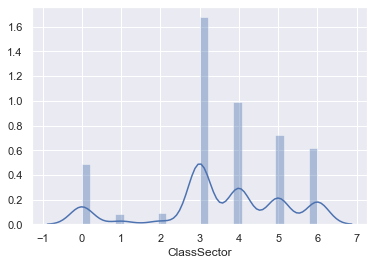

In [90]:
sns.set(color_codes=True)

sns.distplot(area_to_check.ClassSector);


In this perimeter we got sectors 4 and 3 like the most, so this rule can be fulfilled. Now, we are going to remove the remaining sectors of the dataset

In [48]:
area_filtered=area_to_check[(area_to_check['ClassSector']==3) | (area_to_check['ClassSector']==4) ]
print(area_filtered.shape)
area_filtered.head()

(3339, 9)


,BlockCode,NeighborhoodCode,Neighborhood,Borough,BoroughCode,ClassSector,SHAPE_Leng,SHAPE_Area,geometry
0,009117062,009117,PRADO VERANIEGO SUR,SUBA,11,3,0.002121,1.281573e-07,"POLYGON ((-74.06196 4.71565, -74.06196 4.71565..."
1,009107057,009107,PRADO VERANIEGO,SUBA,11,3,0.002875,5.128493e-07,"POLYGON ((-74.05354 4.71583, -74.05355 4.71573..."
2,009107089,009107,PRADO VERANIEGO,SUBA,11,3,0.002077,2.278038e-07,"POLYGON ((-74.05601 4.71601, -74.05602 4.71598..."
4,009107045,009107,PRADO VERANIEGO,SUBA,11,3,0.002874,5.160376e-07,"POLYGON ((-74.05436 4.71591, -74.05437 4.71581..."
5,009107069,009107,PRADO VERANIEGO,SUBA,11,3,0.001862,1.972670e-07,"POLYGON ((-74.05277 4.71612, -74.05278 4.71603..."


Before we continue, let us review whether the data removed for lack of information regarding the classification sectors could affect the analysis.

In [49]:
area_to_wo = gpd.overlay( circle, null_data, how='intersection')
map_Bogota = folium.Map(location=[latitude, longitude], zoom_start=10)
folium.GeoJson(circle['geometry']).add_to(map_Bogota)
folium.GeoJson(area_to_wo['geometry']).add_to(map_Bogota)
map_Bogota

We note that the vast majority of these data are public areas that do not affect the analysis. However, there are areas towards the east of the city that do not have information, but upon a good review, it is a neighborhood that does not belong to the urban area of Bogota and can be discarded.

### Data Selection

#### With the above, we can finally obtain our data set for analysis.

In [50]:
area_filtered['color']=np.where(area_filtered['ClassSector']==4,'green', 'blue')
area_filtered.head()

<ipython-input-50-0dda9f55202d>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  area_filtered['color']=np.where(area_filtered['ClassSector']==4,'green', 'blue')


,BlockCode,NeighborhoodCode,Neighborhood,Borough,BoroughCode,ClassSector,SHAPE_Leng,SHAPE_Area,geometry,color
0,009117062,009117,PRADO VERANIEGO SUR,SUBA,11,3,0.002121,1.281573e-07,"POLYGON ((-74.06196 4.71565, -74.06196 4.71565...",blue
1,009107057,009107,PRADO VERANIEGO,SUBA,11,3,0.002875,5.128493e-07,"POLYGON ((-74.05354 4.71583, -74.05355 4.71573...",blue
2,009107089,009107,PRADO VERANIEGO,SUBA,11,3,0.002077,2.278038e-07,"POLYGON ((-74.05601 4.71601, -74.05602 4.71598...",blue
4,009107045,009107,PRADO VERANIEGO,SUBA,11,3,0.002874,5.160376e-07,"POLYGON ((-74.05436 4.71591, -74.05437 4.71581...",blue
5,009107069,009107,PRADO VERANIEGO,SUBA,11,3,0.001862,1.972670e-07,"POLYGON ((-74.05277 4.71612, -74.05278 4.71603...",blue


In [51]:
map_Bogota = folium.Map(location=[latitude, longitude], zoom_start=10)
# folium.GeoJson(circle['geometry']).add_to(map_Bogota)
folium.GeoJson(area_filtered['geometry'],).add_to(map_Bogota)
folium.GeoJson(
    area_filtered,
    style_function=lambda feature: {
        'fillColor':feature['properties']['color'],
        'color' : feature['properties']['color'],
        'weight' : 1,
        'fillOpacity' : 0.5,
        }
    ).add_to(map_Bogota)

map_Bogota

To be able to better analyze each point, it is more convenient to have points and not polygons, that is why the centroid of each shape is obtained.

In [52]:
area_filtered_points=area_filtered.copy()
area_filtered_points['Latitude']=area_filtered_points.geometry.centroid.y
area_filtered_points['Longitude']=area_filtered_points.geometry.centroid.x
area_filtered_points.reset_index(inplace=True)
print (area_filtered_points.shape)
area_filtered_points.drop(columns='color', inplace=True)
area_filtered_points.head()

(3339, 13)


,index,BlockCode,NeighborhoodCode,Neighborhood,Borough,BoroughCode,ClassSector,SHAPE_Leng,SHAPE_Area,geometry,Latitude,Longitude
0,0,009117062,009117,PRADO VERANIEGO SUR,SUBA,11,3,0.002121,1.281573e-07,"POLYGON ((-74.06196 4.71565, -74.06196 4.71565...",4.716081,-74.061756
1,1,009107057,009107,PRADO VERANIEGO,SUBA,11,3,0.002875,5.128493e-07,"POLYGON ((-74.05354 4.71583, -74.05355 4.71573...",4.716120,-74.053853
2,2,009107089,009107,PRADO VERANIEGO,SUBA,11,3,0.002077,2.278038e-07,"POLYGON ((-74.05601 4.71601, -74.05602 4.71598...",4.716180,-74.056352
3,4,009107045,009107,PRADO VERANIEGO,SUBA,11,3,0.002874,5.160376e-07,"POLYGON ((-74.05436 4.71591, -74.05437 4.71581...",4.716210,-74.054668
4,5,009107069,009107,PRADO VERANIEGO,SUBA,11,3,0.001862,1.972670e-07,"POLYGON ((-74.05277 4.71612, -74.05278 4.71603...",4.716227,-74.053052


## 4. Analysis <a name="analysis"></a>

As mentioned in the methodology, it is important to first survey the stakeholders to find out what interest they have with respect to the nearby venues. This will allow the creation of a table of categories to filter in the search.

In [ ]:

 # create URL
url = 'https://api.foursquare.com/v2/venues/categories?&client_id={}&client_secret={}&v={}'.format(
    CLIENT_ID, 
    CLIENT_SECRET, 
    VERSION, 
    location_center.latitude, 
    location_center.longitude, 
    radius, 
    LIMIT)
# display URL


In [54]:
resultsCategories = requests.get(url).json()
with open('categories.json', 'w') as json_file:
    json.dump(resultsCategories, json_file)

Since not all categories are necessary for this analysis, e.g. a car store is not important but a supermarket is, a manual filtering of the JSON file is done to generate a csv file.

In [78]:
categories_type=pd.read_csv('categories.csv',header=1)
print(categories_type.shape)
categories_type.head()

(100, 3)


,Name,Id,Type
0,General Entertainment,4bf58dd8d48988d1f1931735,Arts_Entertainment
1,American Restaurant,4bf58dd8d48988d14e941735,To_Eat
2,Asian Restaurant,4bf58dd8d48988d142941735,To_Eat
3,BBQ Joint,4bf58dd8d48988d1df931735,To_Eat
4,Bakery,4bf58dd8d48988d16a941735,To_Eat


We will create a new dataframe with the ratings obtained for the filtering process.

In [56]:
categories_headers=categories_type[['Type']].groupby('Type').count().T.reset_index().to_dict()
categories_headers=pd.DataFrame.from_dict(categories_headers, orient='columns').drop(columns='index')
categories_headers['Others']=[]
categories_headers

,Arts_Entertainment,Food_Drink_Shop,Health_Services,NightLife,Outdoors,Professional_Services,Public_Transportation,Shop_and_Services,To_Eat,Others


### Taking all the venues

First, we have to define a function to get the cateories from the categories dataframe

In [57]:
# function that extracts the category of the venue
def get_generic_category_type(row):
    #import re
    try:
        categories_list = row['categories']
    except:
        categories_list = row['venue.categories']
    if len(categories_list) == 0:
        return None
    else:
        if categories_list[0]['id'] in categories_type['Id'].values:
            #print(categories_list[0]['name'],categories_type[categories_type['Id']==categories_list[0]['id']].reset_index().Type[0])  
            return str(categories_type[categories_type['Id']==categories_list[0]['id']].reset_index().Type[0])
        else:
            #print(categories_list[0]['id'],categories_list[0]['name'])
            return 'Others'
        #return re.search('categories_v2/(.+?)/', categories_list[0]['icon']['prefix']).group(1)

Now, we will get all the venues from each point obtained in area_filtered_points. The radius will be 500m and regular queries are made using the API.

In [91]:
def get_venues (row):
    
    latitude = row['Latitude']
    longitude = row['Longitude']
    Limit=50
    radius = 500
    
    url = 'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}'.format(
    CLIENT_ID, 
    CLIENT_SECRET, 
    VERSION, 
    latitude, 
    longitude, 
    radius, 
    LIMIT)
    error_attempt=0
    results = requests.get(url).json()
    try:
        venues = results['response']['groups'][0]['items']
    except:
            try:
                results = requests.get(url).json()
                venues = results['response']['groups'][0]['items']
            except:
                try:
                    results = requests.get(url).json()
                    venues = results['response']['groups'][0]['items']
                except:
                    print(results,url,'Tercer intento')
                    raise Exception('Query Error, please check the messagge from result file')
         
    
    nearby_venues = pd.json_normalize(venues) # flatten JSON
    
    # filter columns
    nearby_venues =nearby_venues.loc[:, ['venue.name','venue.categories']]
    
    categories=categories_headers.copy()
    # filter the category for each row
    #nearby_venues['venue.categories'] =  nearby_venues['venue.categories']#[0]['icon']['prefix'] 

    nearby_venues['venue.categories'] = nearby_venues.apply(get_generic_category_type, axis=1)
    categories_group=nearby_venues.groupby('venue.categories').count().T
    for pos, value in enumerate(categories_group):
        categories.loc[0,value]=categories_group.loc['venue.name',value]
    return categories.fillna(0)#.values.tolist()

In [ ]:
venues_serie=area_filtered_points.apply(get_venues, axis=1)

In [ ]:
venues_df=categories_headers.copy()
for pos, value in enumerate(venues_serie):
    venues_df=venues_df.append(venues_serie[pos], ignore_index=True).astype('int')

In [59]:
print(venues_df.shape)
venues_df.head()

(3339, 10)


,Arts_Entertainment,Food_Drink_Shop,Health_Services,NightLife,Outdoors,Professional_Services,Public_Transportation,Shop_and_Services,To_Eat,Others
0,0,0,0,0,0,0,0,1,4,1
1,0,1,0,1,0,1,0,1,6,1
2,0,1,0,1,0,1,0,2,7,2
3,0,1,0,1,0,1,0,1,7,1
4,0,1,0,1,0,2,0,1,7,1


In [60]:
print(area_filtered_points.shape)

(3339, 12)


#### Finally we can obtain each category of the points of interest that were consulted in the survey.

In [61]:
area_with_venues=pd.concat([area_filtered_points,venues_df],axis=1, join='inner')

In [62]:
print(area_with_venues.shape)
area_with_venues.drop(columns='index', inplace=True)
area_with_venues.head()

(3339, 22)


,BlockCode,NeighborhoodCode,Neighborhood,Borough,BoroughCode,ClassSector,SHAPE_Leng,SHAPE_Area,geometry,Latitude,Longitude,Arts_Entertainment,Food_Drink_Shop,Health_Services,NightLife,Outdoors,Professional_Services,Public_Transportation,Shop_and_Services,To_Eat,Others
0,009117062,009117,PRADO VERANIEGO SUR,SUBA,11,3,0.002121,1.281573e-07,"POLYGON ((-74.06196 4.71565, -74.06196 4.71565...",4.716081,-74.061756,0,0,0,0,0,0,0,1,4,1
1,009107057,009107,PRADO VERANIEGO,SUBA,11,3,0.002875,5.128493e-07,"POLYGON ((-74.05354 4.71583, -74.05355 4.71573...",4.716120,-74.053853,0,1,0,1,0,1,0,1,6,1
2,009107089,009107,PRADO VERANIEGO,SUBA,11,3,0.002077,2.278038e-07,"POLYGON ((-74.05601 4.71601, -74.05602 4.71598...",4.716180,-74.056352,0,1,0,1,0,1,0,2,7,2
3,009107045,009107,PRADO VERANIEGO,SUBA,11,3,0.002874,5.160376e-07,"POLYGON ((-74.05436 4.71591, -74.05437 4.71581...",4.716210,-74.054668,0,1,0,1,0,1,0,1,7,1
4,009107069,009107,PRADO VERANIEGO,SUBA,11,3,0.001862,1.972670e-07,"POLYGON ((-74.05277 4.71612, -74.05278 4.71603...",4.716227,-74.053052,0,1,0,1,0,2,0,1,7,1


### Cluster Blocks


It is necessary to group all the data based on their common characteristics such as classificaction sector, how many places to eat nearby, how many grocery stores are nearby, etc. For this purpose it was seen as more convenient to use the **k-means algorithm** because it allows to measure that similarity between points for unsupervised data.


In [63]:
# set number of clusters
kclusters = 5


Clus_dataSet = area_with_venues[['ClassSector','Arts_Entertainment','Food_Drink_Shop','Health_Services','NightLife','Outdoors','Professional_Services','Public_Transportation','Shop_and_Services','To_Eat']]


# run k-means clustering
kmeans = KMeans(n_clusters=kclusters, random_state=0).fit(Clus_dataSet)


# check cluster labels generated for each row in the dataframe
kmeans.labels_[0:10] 

array([2, 2, 2, 2, 2, 2, 2, 2, 2, 2], dtype=int32)

In [64]:
# add clustering labels
area_with_venues_KM=area_with_venues.copy()
area_with_venues_KM['ClusterLabels']= kmeans.labels_


#oldtoronto_merged.head() # check the last columns!
area_with_venues_KM.head()

,BlockCode,NeighborhoodCode,Neighborhood,Borough,BoroughCode,ClassSector,SHAPE_Leng,SHAPE_Area,geometry,Latitude,Longitude,Arts_Entertainment,Food_Drink_Shop,Health_Services,NightLife,Outdoors,Professional_Services,Public_Transportation,Shop_and_Services,To_Eat,Others,ClusterLabels
0,009117062,009117,PRADO VERANIEGO SUR,SUBA,11,3,0.002121,1.281573e-07,"POLYGON ((-74.06196 4.71565, -74.06196 4.71565...",4.716081,-74.061756,0,0,0,0,0,0,0,1,4,1,2
1,009107057,009107,PRADO VERANIEGO,SUBA,11,3,0.002875,5.128493e-07,"POLYGON ((-74.05354 4.71583, -74.05355 4.71573...",4.716120,-74.053853,0,1,0,1,0,1,0,1,6,1,2
2,009107089,009107,PRADO VERANIEGO,SUBA,11,3,0.002077,2.278038e-07,"POLYGON ((-74.05601 4.71601, -74.05602 4.71598...",4.716180,-74.056352,0,1,0,1,0,1,0,2,7,2,2
3,009107045,009107,PRADO VERANIEGO,SUBA,11,3,0.002874,5.160376e-07,"POLYGON ((-74.05436 4.71591, -74.05437 4.71581...",4.716210,-74.054668,0,1,0,1,0,1,0,1,7,1,2
4,009107069,009107,PRADO VERANIEGO,SUBA,11,3,0.001862,1.972670e-07,"POLYGON ((-74.05277 4.71612, -74.05278 4.71603...",4.716227,-74.053052,0,1,0,1,0,2,0,1,7,1,2


#### Distribution of cluster into the dataset


In [99]:
area_with_venues_KM.groupby('BoroughCode')

,BlockCode,NeighborhoodCode,Neighborhood,Borough,BoroughCode,ClassSector,SHAPE_Leng,SHAPE_Area,geometry,Latitude,Longitude,Arts_Entertainment,Food_Drink_Shop,Health_Services,NightLife,Outdoors,Professional_Services,Public_Transportation,Shop_and_Services,To_Eat,Others,ClusterLabels


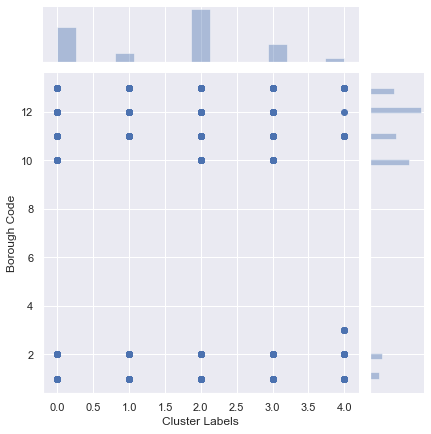

In [107]:
sns.set(color_codes=True)
sns.jointplot(x=area_with_venues_KM.ClusterLabels.values.astype('int'),y=area_with_venues_KM.BoroughCode.values.astype('int')).set_axis_labels('Cluster Labels', 'Borough Code')

In [66]:
area_summary=area_with_venues_KM.groupby('ClusterLabels').mean()[['Arts_Entertainment','Food_Drink_Shop','Health_Services','NightLife','Outdoors','Professional_Services','Public_Transportation','Shop_and_Services','To_Eat']]
area_summary

,Arts_Entertainment,Food_Drink_Shop,Health_Services,NightLife,Outdoors,Professional_Services,Public_Transportation,Shop_and_Services,To_Eat
ClusterLabels,,,,,,,,,
0,0.088620,0.776435,0.0,0.565962,0.436052,0.463243,0.002014,0.807654,10.754280
1,0.130612,0.979592,0.0,3.865306,0.387755,0.800000,0.000000,2.906122,32.346939
2,0.004711,0.323015,0.0,0.122476,0.294751,0.340511,0.024226,0.639973,4.325707
3,0.072407,0.968689,0.0,1.446184,0.475538,0.714286,0.000000,1.684932,19.812133
4,0.086538,1.086538,0.0,5.144231,0.663462,1.009615,0.000000,3.144231,49.836538


In [67]:
scaler = MinMaxScaler()
area_summaryN=pd.DataFrame(scaler.fit_transform(area_summary),columns=area_summary.columns)
area_summaryN

,Arts_Entertainment,Food_Drink_Shop,Health_Services,NightLife,Outdoors,Professional_Services,Public_Transportation,Shop_and_Services,To_Eat
0,0.666470,0.593852,0.0,0.088313,0.383231,0.183426,0.083138,0.066958,0.141254
1,1.000000,0.859930,0.0,0.745323,0.252241,0.686722,0.000000,0.904919,0.615705
2,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000
3,0.537693,0.845650,0.0,0.263595,0.490323,0.558619,0.000000,0.417273,0.340280
4,0.649935,1.000000,0.0,1.000000,1.000000,1.000000,0.000000,1.000000,1.000000


#### A barplot will be able to show us the facilities of each cluster

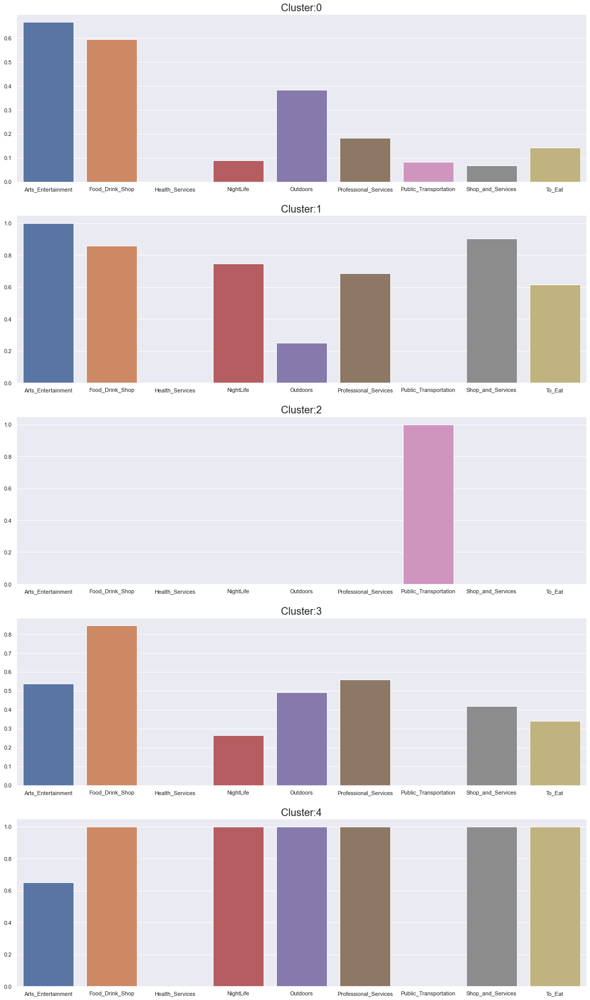

In [110]:
fig, axs = plt.subplots(max(kmeans.labels_)+1, figsize=(20, (max(kmeans.labels_)+1)*7))
sns.set(color_codes=True)
bins=categories_headers.columns.tolist()
for index, row in area_summaryN.iterrows():
    fg=sns.barplot(row.index,row.values,ax=axs[index])
    fg.set_title('Cluster:{}'.format(index), fontsize=20);

### Map where the different selected clusters are highlighted.

In [69]:
# function set a color to each point

def get_cluster_color(cluster):
    #try:
    #   categories_list = row['categories']
    #except:
    #    categories_list = row['venue.categories']
    
    if cluster == 0:
        return 'blue'
    elif cluster == 1:
        return 'darkgreen'
    elif cluster == 2:
        return 'red'    
    elif cluster == 3:
        return 'cadetblue'
    elif cluster == 4:
        return 'beige'
    else:
        return '#000000'
    

In [70]:
icon_create_function = """\
function(cluster) {
    return L.divIcon({
   html: '<div><span style="color: #000000;">' + cluster.getChildCount() + '</span></div>',
    className: 'marker-cluster marker-cluster-small',
    
    iconSize: new L.Point(40, 40)
    });
}"""

In [71]:
from folium import plugins

# let's start again with a clean copy of the map of San Francisco
bogota_map = folium.Map(location = [latitude, longitude], zoom_start = 12)

# instantiate a mark cluster object for the clusters in the dataframe

clusters_MC=[None] * (max(kmeans.labels_)+1)
for i in range(max(kmeans.labels_)+1):
    clusters_MC[i] = plugins.MarkerCluster(
        name='Cluster 0',
        overlay=True,
        control=True,
        icon_create_function=icon_create_function.replace('#000000', get_cluster_color(i))
    ).add_to(bogota_map)

    # loop through the dataframe and add each data point to the mark cluster
    for index, row in area_with_venues_KM[area_with_venues_KM['ClusterLabels']==i].iterrows():
        folium.Marker(
            location=[row.Latitude, row.Longitude],
            icon=folium.Icon(color=get_cluster_color(i),icon='glyphicon glyphicon-map-marker'),
            popup='{}, cluster:{}'.format(row.Neighborhood,row.ClusterLabels),
            
            
        ).add_to(clusters_MC[i])





In [72]:
legend_html =   '''
                <div style="position: fixed; 
                            bottom: 50px; left: 50px; width: 100px; height: 135px; 
                            border:2px solid grey; z-index:9999; font-size:14px; background-color:#86BDD8;
                            ">&nbsp; &nbsp; <strong>Legend</strong> <br>
                              &nbsp; Cluster 0 &nbsp; <i class="glyphicon glyphicon-map-marker" style="color:blue"></i>
                              &nbsp; Cluster 1 &nbsp; <i class="glyphicon glyphicon-map-marker" style="color:darkgreen"></i>
                              &nbsp; Cluster 2 &nbsp; <i class="glyphicon glyphicon-map-marker" style="color:red"></i>
                              &nbsp; Cluster 3 &nbsp; <i class="glyphicon glyphicon-map-marker" style="color:cadetblue"></i>
                              &nbsp; Cluster 4 &nbsp; <i class="glyphicon glyphicon-map-marker" style="color:beige"></i>
                </div>
                ''' 
bogota_map.get_root().html.add_child(folium.Element(legend_html))
bogota_map



To conclude our analysis, we need to visualize in a practical and concise way how the clusters are distributed in all the neighbourhoods. To do this we will use the ***wordclouds*** for each cluster, and so, with the bargraphs represented above, we can expose the different options to the couples.

In [73]:
# import package and its set of stopwords
from wordcloud import WordCloud
print ('Wordcloud is imported!')

Wordcloud is imported!


Create a word cloud object and generate a word cloud. For simplicity, let's generate a word cloud using only the first 2000 words in the novel.

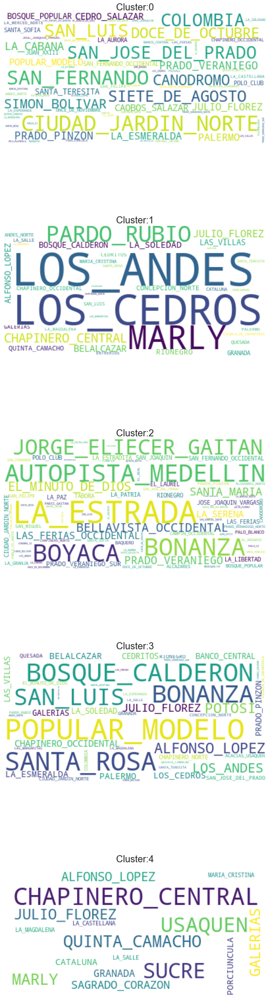

In [120]:
fig, axs = plt.subplots(max(kmeans.labels_)+1, figsize=(30, (max(kmeans.labels_)+1)*7))
# clusters_wc=[None] * (max(kmeans.labels_)+1)
for cluster_sel in range((max(kmeans.labels_)+1)):
    # instantiate a word cloud object
    clusters_wc = WordCloud(
    background_color='white',
    collocations = False,
    )
    lista=area_with_venues_KM[area_with_venues_KM['ClusterLabels']==cluster_sel].Neighborhood
    unique_string=("/").join(lista).replace(' ','_')
    unique_string=unique_string.replace('/'," ")
    # generate the word cloud
    clusters_wc.generate(unique_string)
    #fig = plt.figure()
    fig.set_figwidth(10) # set width
    fig.set_figheight(40) # set height

    # display the cloud
    axs[cluster_sel].imshow(clusters_wc, interpolation='bilinear')
    axs[cluster_sel].axis('off')
    axs[cluster_sel].set_title('Cluster:{}'.format(cluster_sel), fontsize=20)

plt.show()

## 5. Results and Discussion <a name="results"></a>

Bogotá has countless neighborhoods where each one offers a variety of services, although each one will depend on the purchasing power of each person. This analysis shows that within a radius of 6km with the center of Parque de la 93 there are different points suitable for living according to the rules of the couple. Bogotá offers a better quality of life towards the north of the city, and this can be seen in the results. Usaquén is one of the places with the highest number of venues, which allows for a better quality of life when choosing a home.

On the other hand, it is important to emphasize that none of the selected points do have medical services nearby, this is because the classification of each sector is being filtered.In addition, the proximity to supermarkets, shops and restaurants is sacrificed for the proximity to bus stations, so this could not meet the initial requirements and would have to rethink that initial idea.

In this analysis, the intention was not to provide the married couple with a place to live since this implies other factors such as availability of rental housing, price, size, among others. However, we would suggest cluster one because it is the one with the most services and also because its nightlife is not so dominant and this allows for a more peaceful life.

For future work we could have a database of prices available for renting, this could give a greater spectrum of analysis of the areas.


## 6. Conclusion <a name="conclusion"></a>

The purpose of this project was to identify possible living areas within a radius of 6 km, taking as a center a point close to the couple's workplaces under established rules: sectors classification 3 and 4 and the largest number of venues within 500 meters. Since the socio-economic classification of Bogotá is by blocks and not by neighborhood, this generated a large amount of data to be analyzed. However, by filtering all the blocks in each neighborhood under these conditions, the number of data could be reduced considerably. We checked that the resulting distribution was within the requested limits, finding that the only thing that could not be met was the proximity of the bus stations.

Finally, we used word clouds and bar charts to present the skateboarders with possible solutions to their problem, where they could review considerations if they wanted more night localities nearby because that could be annoying or if it is more important the art sites among others.